# Chapter 10. Introduction to Artificial Neural Networks with Keras

## From Biological to Artificial Neurons
**Why this new wave of interest in AI is different?**
* **There is now a huge quantity of data avaliable to train neural networks, and ANNs frequently outperform other ML techniques on very large and complex problems**
* **The tremendous increase in computing power has now made it possible to train lage neural networks in a reasonable amount of time.**
* **The training algorithms have been improved**
* **Some theoretical limitations of ANNs have truned out to be benign in practice.**
* **ANNs seem to have entered a virtuous circle of funding and progress.**

## Logical Computation with Neurons
* **Artificial neuron: it has one or more binary(on/off) inputs and one binary output.**
* **The artificial neuron activates its output when more than a certain number of its inputs are active.**
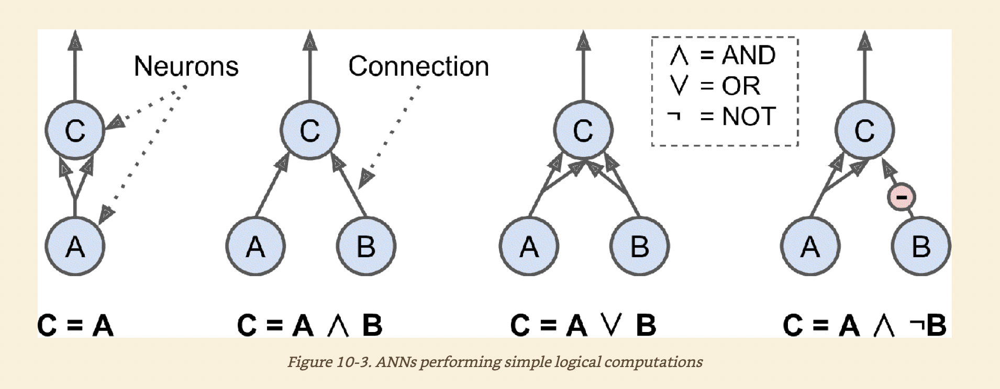
* **The first network on the left is the identity function: if neuron A is activated, then neuron C gets activated as well(since it receives two input signals from neuron A); but if neuron A is off, then neuron C is off as well.**
* **The second network performs a logical AND: neuron C is activated only when both neurons A and B are activated(a single input signal is not enough to activate neuron C).**
* **The third network performs a logical OR: neuron C gets activated if either neuron A or neuron B is activated.**
* **Finally, if we suppose that an input connection can inhibit the neuron's activity(which is the case with biological neurons), then the fourth network computes a slightly more complex logical proposition: neuron C is activated only if neuron A is active and neuron B is off. If neurn A is active all the time, then you get a logical NOT: neuron C is active when neuron B is off, and vice versa.**

### The perceptron
* **Base on a slightly different artificial neuron, called a *threshold logic unit*(TLU), or sometimes a *linear threshold unit*(LTU).**
* **The inputs and output are numbers(instead of binary on/off values), and each input connection is associated with a weight.**
* **The TLU computes a weighted sum of its inputs($z = w_1 x_1 + w_2 x_2+...+w_nx_n = \pmb{x}^{T} \pmb{w} $), then applies a *step function* to that sum and outputs the result: 
$$ h_{\pmb{w}} (\pmb{x}) = step(z)$$, where** $z = \pmb{x}^{T} \pmb{w} $
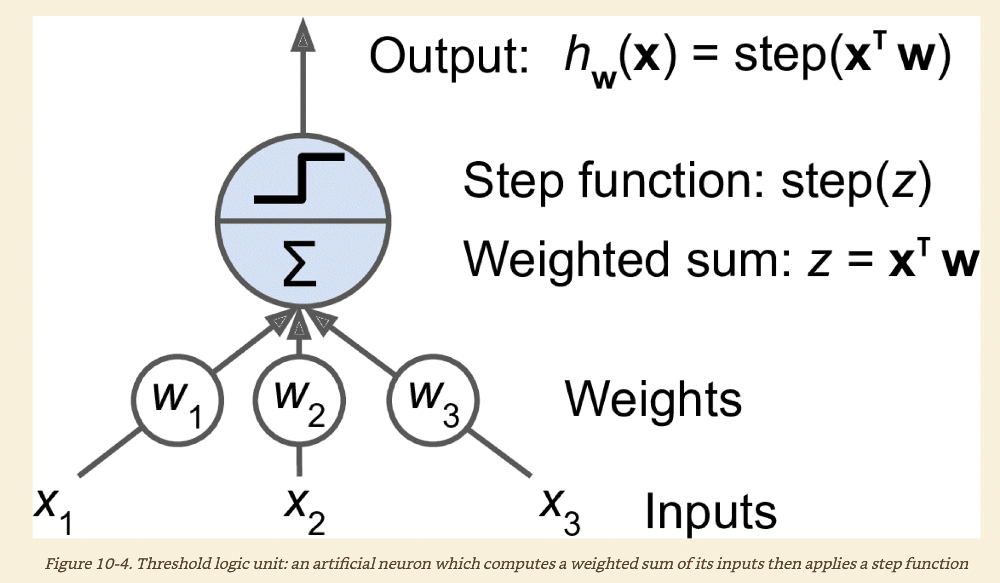
* **The most common step function used in Perceptrons is the *Heaviside step function*, sometimes the sign function is used instead. Training a TLU in this case means finding the right values for $w_0, w_1, w_2$.**
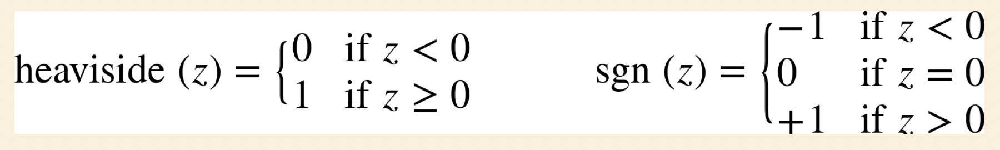
* **A Perceptron is simply composed of a single layer of TLUs, with each TLU connected to all inputs. When all neurons in a layer are connected to every neuron in the previous layer(i.e., its input neurons), the layer is called a *fully connected layer*, or a *dense layer*.**
* **The inputs of the perceptrons are fed to a special passthrough neuorns called *input neurons*, they output whatever they are fed.**
    * **All input neurons form the *input layer*.**
    * **An extera bias feature is generally added($x_0 = 1)$: it is typically represented using a special type of neuron called a *bias neuron*, which outputs $1$ all the time.**
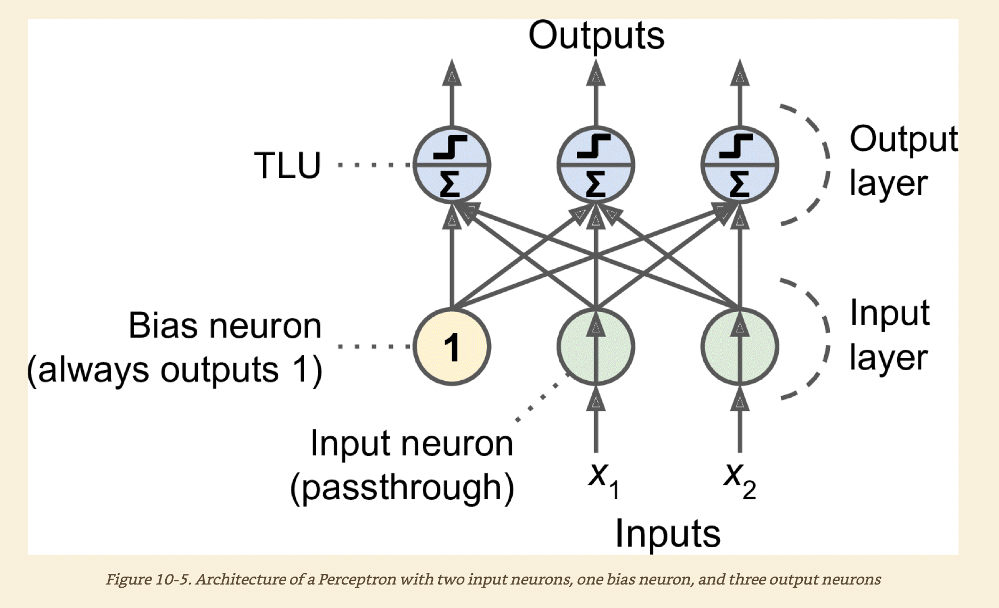
$$ \mathcal{h}_{\pmb{W}, \pmb{b}}(\pmb{X}) = \phi (\pmb{XW} + \pmb{b}) $$
* $\pmb{X}$ **represents the matrix of input features. It has one row per instance and one column per feature.**
* **The weight matrix $\pmb{W}$ contains all the connection weights except for the ones from the bias neuron. It has one row per input neuron and one column per artificial neuron layer.**
* **The bias vector $\pmb{b}$ contains all the connection wieghts between the bias neuron and the artificial neurons. It has one bias term per artificial neuron.**
* **The function $\varphi$ is called the *activation function*: when the artificial neurons are TLUs, it is a step funciton.**

**Perceptron Learning Rule**<br>
$$ \mathcal{w}_{i, j}^{(next step)} = w_{i, j} + \eta ( y_j - \hat{y}_j) x_j $$
* **Hebb's rule: the connection weight between two neurons tends to increase when they fire simultaneously.**
* **The Perceptron learning rule: Built on the idea of Hebb's rule. Takes into account the error made by the network when it makes a prediction. The perceptron is fed one training instance at a time, and fro each instance it makes its predictions. For every output neuron that produced a wrong prediction, it reinforces the connection wights from the inputs that would have contributed to the correct prediction.**
* $w_{i, j} $ is the connection weight between the ith input neuron and the jth output neuron.
* $x_i$ is the ith input values of the current training instance.
* $\hat{y}_j$ is the output of the jth output neuron for the current training instance
* $y_j$ is the target output of the jth output neiuron for the current training instance
* $\eta$ is the learning rate.
* **The decision boundary of each output neuron is linear, so Perceptrons are incapable of learning complex patterns. However, if the training instances are linearly separable, this algorithm would converge to a solution.**

In [1]:
import numpy as np
from sklearn.datasets import load_iris
from sklearn.linear_model import Perceptron

In [3]:
iris = load_iris()
X = iris.data[:, (2, 3)] # Petal length, petal width
y = (iris.target == 0).astype(np.int) # Iris setosa?


per_clf = Perceptron()
per_clf.fit(X, y)

y_pred = per_clf.predict([[2, 0.5]])

* **SK-Learn's** Perceptron **class is equivalent to using an** SGDClassifier **with the following hyperparameters:** loss = "perceptron", learning_rate = "constant, eta0 = 1(the learning rate), penalty = None(no regularization)
**Limitations of Perceptron**<br>
* **Incapable of solving some trivial porblems(e.g., the *Exclusive OR(XOR) classification problem.)** [see complete explanation here](https://medium.com/@jayeshbahire/the-xor-problem-in-neural-networks-50006411840b)
* **Some of the limitations of Perceptorn can be eliminated by stacking multiple Perceptrons. The resulting ANN is called a *Multilayer Perceptron*(MLP).**
    * **An MLP can solve the XOR porblem.**
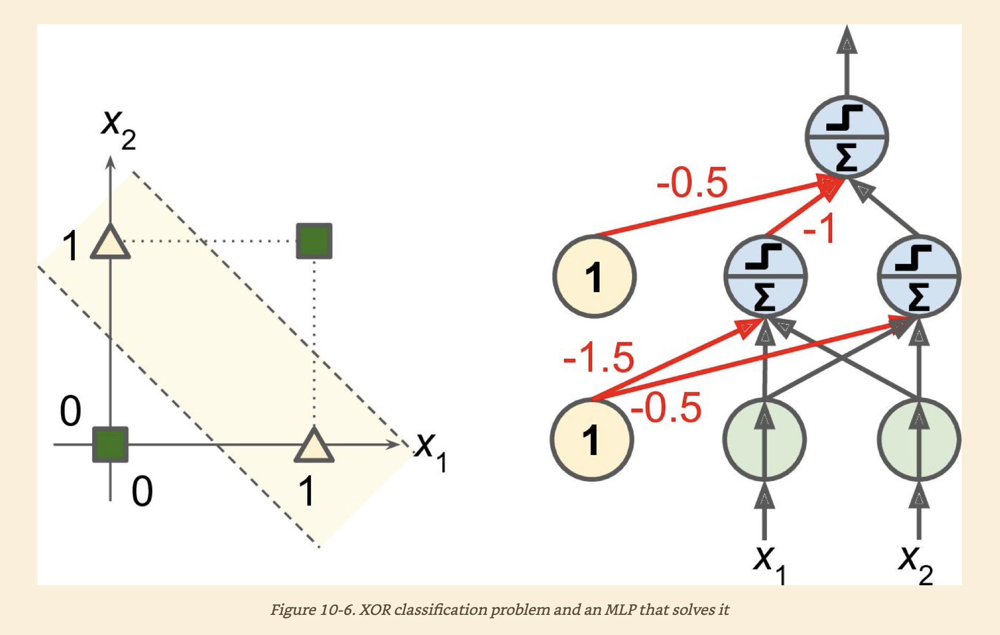

### The Multilayer Perceptron and Backpropagation
* **An MLP is composed of one (passthrough) input later, one or more layers of TLUs, called *hidden layers*, and one layer of TLU called the *output layer*.**
    * **The layers close to the input layer are usually called the *lower layers*, and the ones close to the outputs are usually called the *upper layers*.**
    * **Every layer excpet the output layer includes a bias neurons and is fully connected to the next layer.**
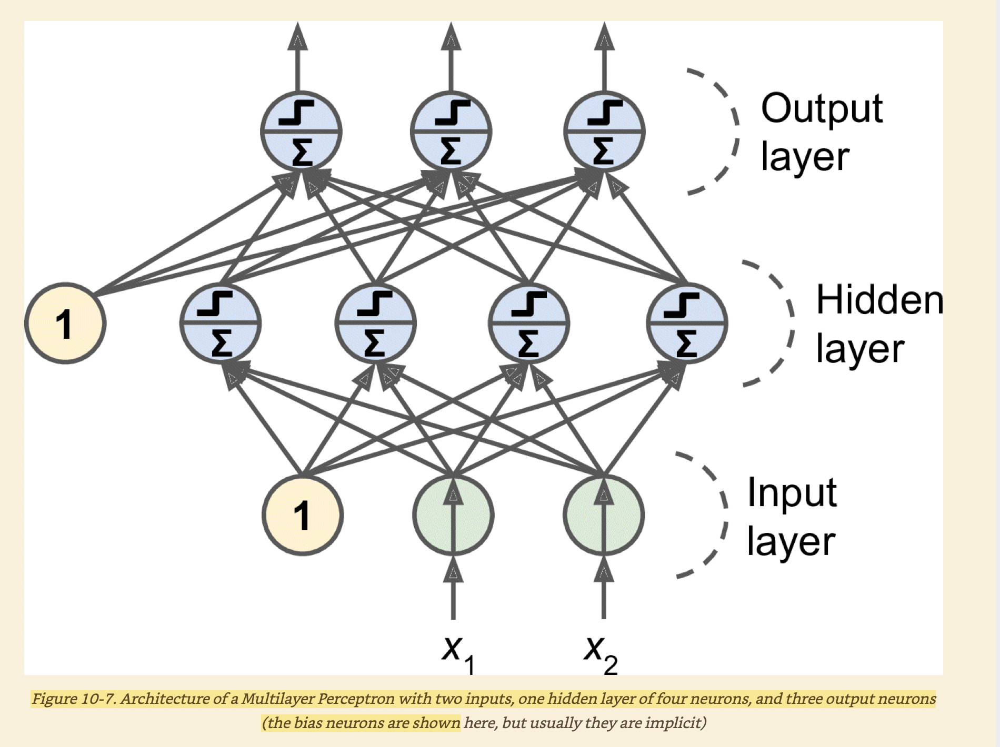

#### Backpropagtion
* **An efficient technique for computing the gradients automatically.**
* **In just two passes through the network(one forward, one backward), the backpropagation algorithm is able to compute the gradients of the network's error with regard to evety single model parameter.**
    * **In other words, it can find out how each connection weight and each bias terms should be tweaked in order to reduce the error.**
    * **Once it has these gradients, it just performs a regular Gradient Descent step, and the whole process is repeated until the network converges to a solution.**
* **It handles one mini-batch at a time, and it goes through the full trianing set multiple times. Each pass is called an *epoch***
* **Each mini-batch is passed to the network's input layer, which sends it to the first hidden layer. The algorithm then computes the output of all the neurons in this layer(for every instance in the mini-batch).**
    * **The result is passed on to the next layer, its output is computed and passed to the next layer, and so on until we get the output of the last layer, and the output layer.**
    * **This is the forward pass: it is exactly like making predicitons, except all intermediate reulsts are preserved since they are needed for the backward pass.**
* **Next, the algorihm measures the network's output error(i.e., it uses a loss function that compares the desired output and actual output of the network, and returns some measure of the error.)**
* **Then it computes how much each output connection contributed to the error. This is done analytically nby applying the *chain rule*, which makes the step fast and precise.**
* **The algorithem then measures how much these error contributions came from each connection in the layer below, again using the chain rule, working backward until the algorithm reaches the input layer, working backward until the algorithm reaches the input layer.**
    * **This reverse pass efficiently measures the error gradient across all the connection weights in the network by propagationg the error gradient backward through the network.**
* **The algorithm performs a Gradient Descent step to tweak all the connection weights in the network, using the error gradient just computed.**

#### Summary of the Backpropagation Algorithm
* **For each training instance, the backpropagation algorithm first makes a prediction(forward pass) and measures the error, then goes through each layer in reverse to measure the error contribution from each connection(reverse pass), and finally tweaks the connectron weights to reduce the error(Gradient Descent step).**
* **It is important to intialize all the hidden layers' connection weights randomly, or else training will fial.**
    * **If you initialize all weights and biases to zero, then neurons in a given layer will be perfectly identical, and thus backpropagatioon will affect them in exactly the same way, so they will remain identical.**
    * **if instead you randomly intialize the weights, you *break the symmetry* and allow backpropagtion to train a diverse team of neurons.**
* **The step function needs to be replaced since the step function contains only flat segments, so there is no gradients to work with.**

##### The hyperbolic tangent function: $ \tanh(z) = 2 \sigma (2z) - 1$
* **Just like the logistic(sigmoid) function: $\sigma(z) = 1 / (1 + \exp(-z))$, this activation function is S-haped, continouos, and differentibale, but its output value ranges from -1 to 1(instead of 0 to 1 in the case of the logistic).That range tends to make each layer's output more or less centered around 0 at the beginning of training, which speeds up convergence.**

##### The Rectified Linear Unit function: $ ReLU(z) = max(0, z) $
* **The ReLU functin is continuous but unfortunately not differentiable at $ z=0$(the slope changes abruptly, which can make Gradient Descent bounce around), and its derivative is $0$ for $z <0$. In practice, this works very well and has the advantange of being fast to compute.**

##### Why do we need activation funciton?
* **If you cahin several linear transformations, all you get is a linear transformation.**
* **Conversely, a large enough DNN with nonlinear activations can theoretically approximate any continuous function.**
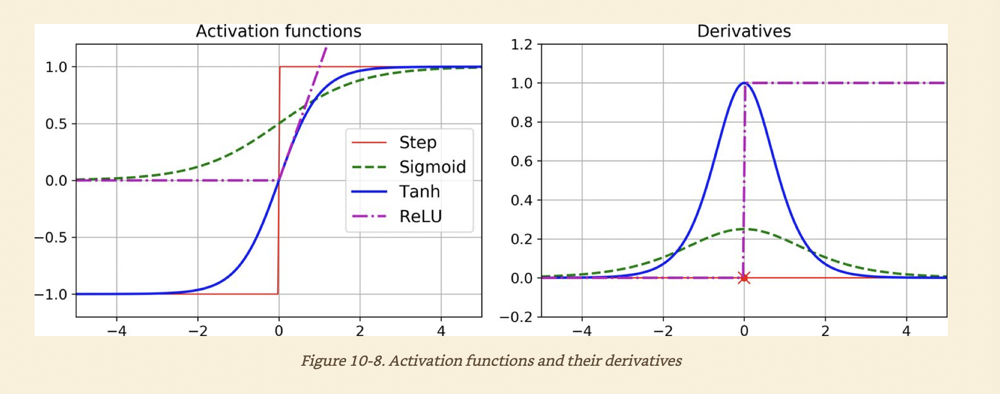

### Regression MLPs
* **MLPs can be used for regression tasks.**
    * **if you want to predict a single value, then you just need a single output neuron: its output is the predicted value.**
    * **For multivariate regression, you need one output neuron per output dimension.**
* **In general, when building an MLP for regression, you do not want to use any activation function for the output neuorns, so they are free to output any range of values.**
    * **In general, when building an MLP for regression, you do not want to use any activation function for the output neurons, so they are free to output any range of values.**
    * **If you want to guarantee that the output will always be positive, then you can use the ReLU activation function in the output layer. Alternatively, you can use the *softplus* activation function, which is a smooth variant of ReLU: $ softplus(z) = \log (1 + exp(z))$. It is close to 0 when z is negative, and close to z when z is positive.**
    * **Finally, if you want to guarantee that the predictions will fall within a given range of values, then you can use the logistic function or the hyperbolic tangent, and then scale the labels to the appropriate range: 0 to 1 for the logistic function and -1 to 1 for the hyperbolic tangent.**
* **The loss function to use during training is typically the mean squared error, but if you have a lot of outliers in the training set, you may prefer to use the mean absolute error instead. Alternatively, you can use the Hubeer loss, which is a combination of both.**
    * **The Huber loss is quadratic when the error is smaller than a threshold $ \delta $(typically 1) but linear when the error is larger than $\delta$. The linear part makes it less sensitve to outliers than the mean squared error, and the quadratic part allows it to converge faster and bemore preceise than the mean absolute error.**

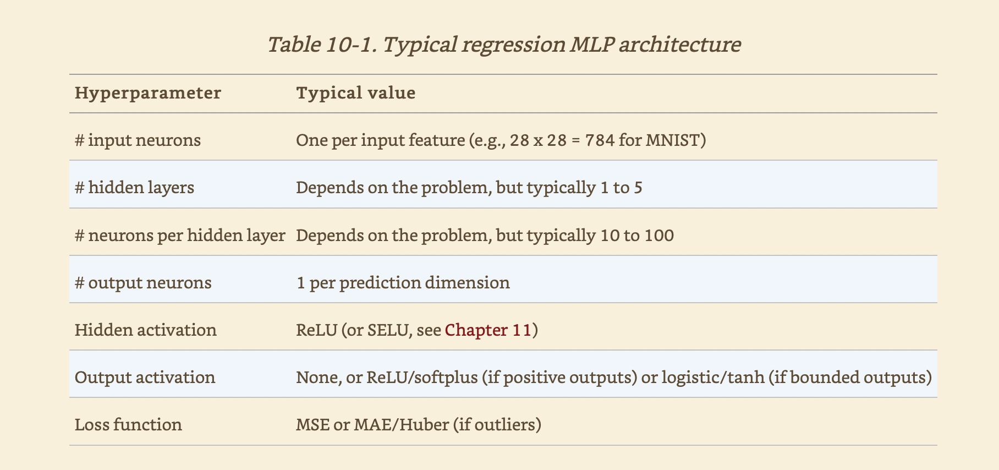

### Classification MLPs
* **MLPs can also be used for classification tasks.**
    * **For a binary classification problem, you just need a single output neuron using the logistic activation function: the output will be a number between 0 and 1, which you can interpret as the estimated probability of the positive class. The esimated probability of the negative class is equal to one minus that number.**
* **MLPs can also handle multilabel classification tasks.**
    * **Need to dedicate one output neuron for each positive class. Note that the output probabilites do not necessarily add up to 1.**
* **MLPs can also handle multiclass classification**
* **If each instance can belong only to a single class, out of three or more possible classes, then you need to have one output neuron per class, and you should use the softmax activation function for the whole output layer.**
    * **The softmax function will ensure that all the estimated probabilities are between 0 and 1 and that they add up to 1(which is required if the classes are exclusive). This is called multiclass clasffication.**
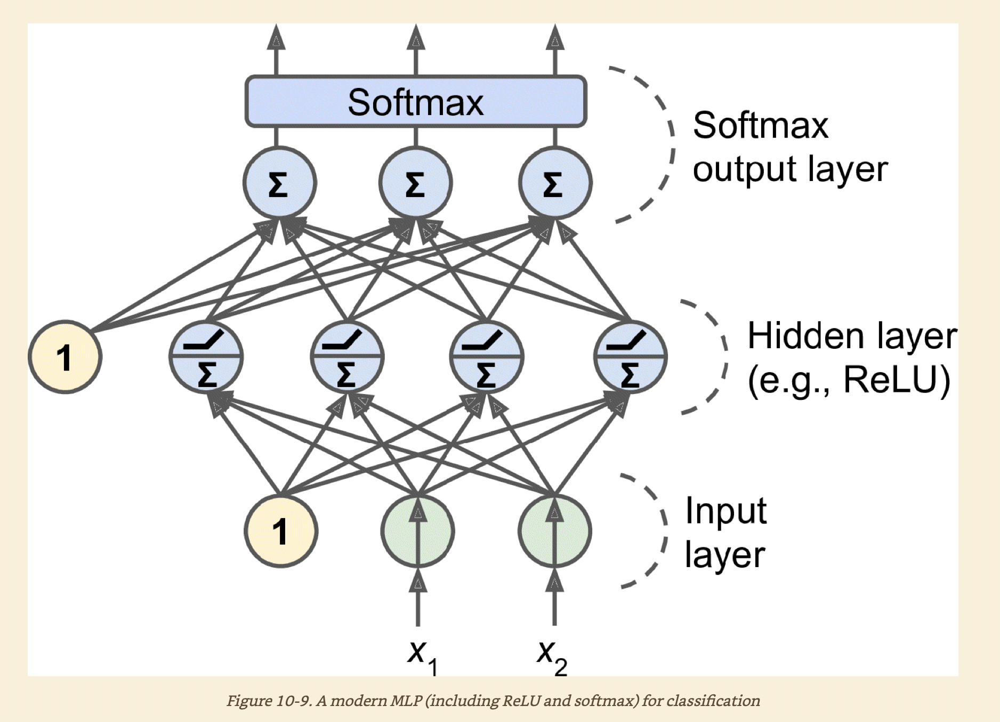
* **Regarding the loss function, since we are predicting probability distribution, the cross-entropy is generally a good choice.**
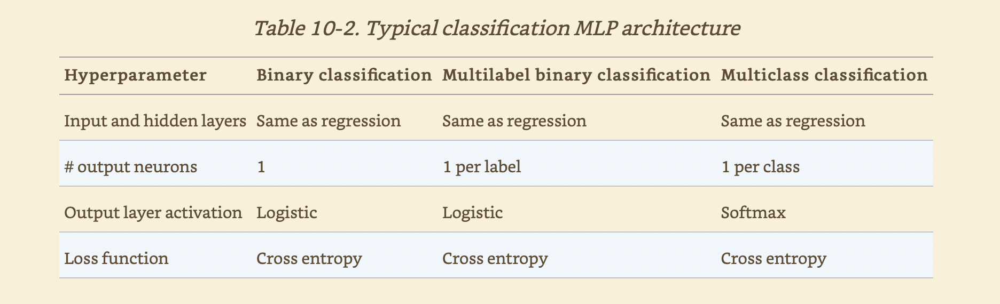

## Implementing MLPs with Keras
* **Keras is a high-level Deep Learning API that allows you to easily build, trainm evaluate, and execute all sorts of neural networks.**
* **To perform the heavy computations required by neural networks, Keras relies on a computatiob backend.**
    * **At present, you can choose from three popular open source Deep Learning libararies: TensorFlow, Microsoft Cognitive Toolkit(CNTK), and Theano.**
    * **Therefore, to avoid any confusion, we will refer to this implementation as *multibackend keras*.**
* **Tensorflow itself now comes bundled with its own keras implementation, tf.keras. It only supports TensorFlow as the backend, but it has the advantage of offering some very useful extra features.**
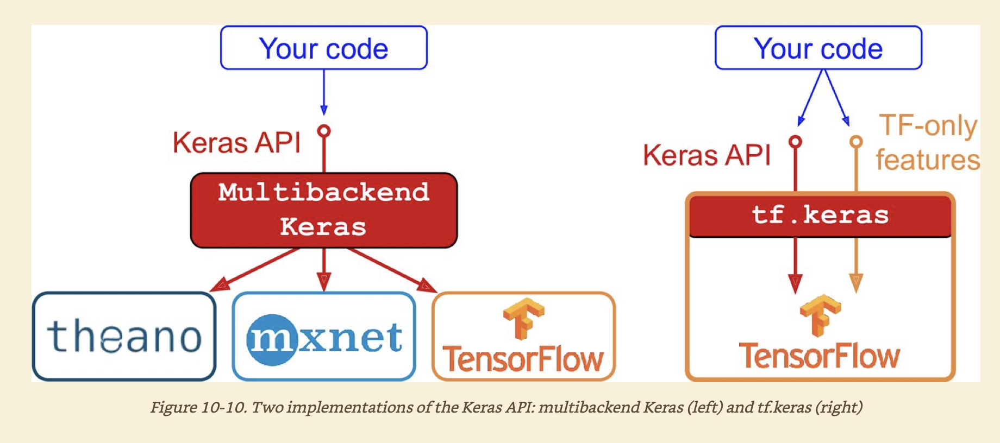

### Installing TensorFlow 2

In [ ]:
pip install tensorflow

**Test your installation**

In [4]:
import tensorflow as tf
from tensorflow import keras
tf.__version__

'2.4.0'

In [5]:
keras.__version__

'2.4.0'

### Building an Image Classifier Using the Sequential API

#### Load the Dataset
* **We will tackle the Fashion MNIST. It has the exact same format as MNIST(70,000 grayscale images of $ 28 \times 28 $ pixels each, with 10 classes), but the images represent fashion items rather than handwritten digits, so each class is more diverse.**

#### Using Keras to load the dataset
* **Keras provides some utility functions to fetch and load some common datasets.**

In [6]:
fashion_mnist = keras.datasets.fashion_mnist
(X_train_full, y_train_full), (X_test, y_test) = fashion_mnist.load_data()

* **Every image is represented as a $ 28 \times 28 $ array rather than a $1D $ array of size $784$.**
* **Moreover, the pixel intensities are represented as integers rather than floats.**

In [7]:
X_train_full.shape

(60000, 28, 28)

In [8]:
X_train_full.dtype

dtype('uint8')

* **Creating a validation set**
* **Since we are going to train the neural network using Gradient Descent, we must scale the input features.**
    * **We'll scale the pixel intensities down to the 0-1 range by dividing them by 255.0**

In [33]:
X_valid, X_train = X_train_full[:5000] / 255.0, X_train_full[5000:]/255.0

In [10]:
y_valid, y_train = y_train_full[:5000], y_train_full[5000:]

In [11]:
X_test = X_test / 255.0

**Create a list of class names**
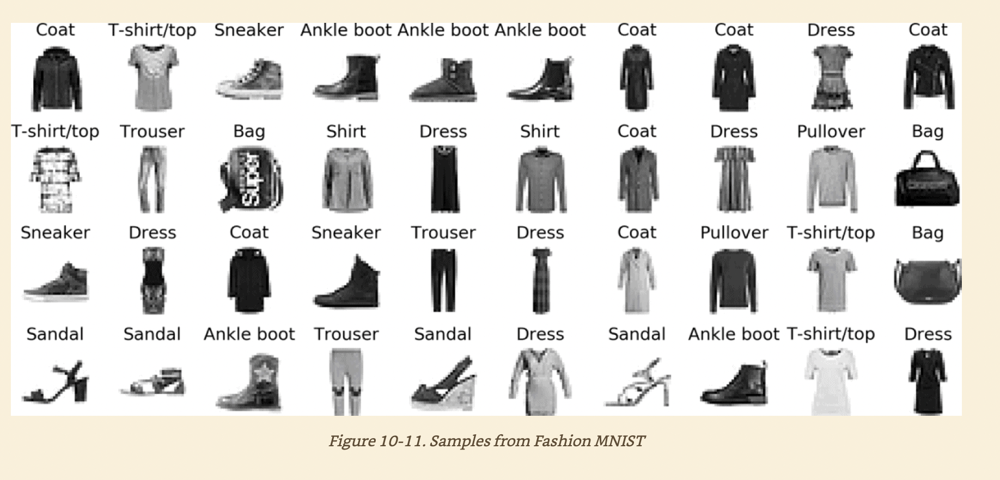

In [12]:
class_names = ["T-shirt/top", "Trouser", "Pullover", "Dress", "Coat", 
              "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"]

In [13]:
class_names[y_train[0]]

'Coat'

### Creating the model using the Sequential API
**A classification MLP with two hidden layers**

In [14]:
model = keras.models.Sequential()
model.add(keras.layers.Flatten(input_shape= [28, 28]))
model.add(keras.layers.Dense(300, activation = "relu"))
model.add(keras.layers.Dense(100, activation = "relu"))
model.add(keras.layers.Dense(10, activation = "softmax"))

* **First line creates a *Sequential* model. This is the simplest kind of Keras model for neural networks that are just composed of a single stack of layers connected sequentially.**
* **Next, we build the first layer and add it to the model. It is a *Flatten* layer whose role is to convert each input image into a 1D arrayL if it receives input data X, it computes X,reshape(-1, 28 * 28).**
    * **This layer does not have any parameters; it is just there to do some simple preprocessing. Since it is the first layer in the model, you shoud specify the *input\_shape*, which doesn't include the batch size, only the shape of the instances.**
    * **Alterantively, you could add a Keras.layers.InputLayers as the first layer, setting** input\_shape = \[28, 28\]
* **Next we add a Dense layer with 300 neurons. It will use the ReLU function.**
    * **Each Dense layer manages its own weight matrix, containing all the connection weights between the neurons and their inputs.**
    * **It also manages a vector of bias terms(one per neuron).**
* **Then we add a second Dense hidden layer with 100 neurons, also using the ReLU activation function.**
* **Finally, we add a Dense output layer with 10 neurons(one per class), using the softmax activation function(because the classes are exclusive)**

**Instead of adding the layers one by one, you can pass a list of layers when creating the Sequential model.**

In [15]:
model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=[28, 28]),
    keras.layers.Dense(300, activation="relu"),
    keras.layers.Dense(100, activation="relu"),
    keras.layers.Dense(10, activation="softmax")
])

**The model's** summary() **method displays all the model's layers, including each layer's name(which is automatically generated unless you set it when creating the layer), its output shape(None means the batch size can be anything), and its number of parameter. The summary ends with the total number of parameters, including trainbal and non-trainable parameters.**

In [16]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_1 (Flatten)          (None, 784)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 300)               235500    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               30100     
_________________________________________________________________
dense_5 (Dense)              (None, 10)                1010      
Total params: 266,610
Trainable params: 266,610
Non-trainable params: 0
_________________________________________________________________


* **Note tha Dense layers often have a lot of parameters. For example, the fist hidden layer has 784 X 300 connection weights, plus 300 bias terms, which adds up to 235,500 parameters.**

**Get a model's list of layers, to fetch by its index, or you can fetch it by name**

In [17]:
model.layers

In [18]:
hidden1 = model.layers[1]

In [19]:
hidden1.name

'dense_3'

In [20]:
model.get_layer('dense_3') is hidden1

True

**All the parameters of a layer can be accessed using its** get\_weights() **and** set\_weights() **methods. For a** Dense **layer, this includes both the connection weights and the bias terms.**

In [21]:
weights, biases = hidden1.get_weights()

In [22]:
weights

array([[ 0.04504239, -0.03672696,  0.02574263, ...,  0.07109867,
        -0.07407126,  0.05949311],
       [ 0.01913241, -0.02007702,  0.00136825, ..., -0.07291184,
         0.06054808,  0.05569795],
       [ 0.05431235, -0.07125226, -0.00742361, ..., -0.02709395,
         0.05976816, -0.00619076],
       ...,
       [ 0.00577447,  0.07129316,  0.01214527, ...,  0.06527443,
        -0.04476848,  0.02124016],
       [-0.04403011,  0.04751167,  0.02282743, ..., -0.0381864 ,
         0.03602271, -0.0153952 ],
       [ 0.05847347,  0.06125167, -0.03690742, ..., -0.02909955,
        -0.06674328,  0.04917908]], dtype=float32)

In [23]:
weights.shape

(784, 300)

In [26]:
biases[:100]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
      dtype=float32)

In [25]:
biases.shape

(300,)

* **Notice that the Dense layer initialzied the connection weights randomly(which is need to break the symmetry), and the biases were intialized to zeros.**
* **If you ever want to use a different intialization method, you can set** kernel_initializer(kernel **is another name for the matrix of connection weights) or** bias_initializer **when creating the layer**

* **The shape of the wieght matrix depends on the number of inputs. This is why it is recommended to sepcify the** input\_shape **when creating the first layer in the** Sequential **model.**
* **If you do not specify the input shape, Keras will wait until it knows the input shape before it actually calls the model.**
    * **this will happen either when you feed it actual data, or when you call the** build( ) **method.**
* **Until the model is really build, the layers will not have any weights, and you will not be able to print the model summary or save the model.**

#### Compiling the Model
* **After the model is created, you must call its** compile() **metjhod to specify the loss function and the optimizer to use.** 
* **You can specify a list of extra metrics to compute during training and evaluation.**

In [30]:
model.compile(loss="sparse_categorical_crossentropy",
             optimizer="sgd",
             metrics=["accuracy"])

* **We use the "sparse_categorical_crossentropy" loss because we have sparse labels(i.e., for each instance, there is just a target class index, from 0 to 9 in this case), and the classes are exclusive.**
    * **If instead we had one target probability per class for each instance(such as one-hot vectors, e.g. \[0, 0, 0, 1, 0, 0, 0, 0, 0\] to represent class 3, then we would need to use the "categorical_crossentropy" loss instead.**
    * **If we were doing binary classification or multilabel binary classification, then we would use the "sigmoid"(i.e., logistic) activation function in the output layer instead of the "softmax" activation function, and we would use the "binary_crossentropy".**
* **If you want to convert sparse labels to one-hot labels, use the** keras.utils.to_categorical() **function. To go the other way round, use the** np.argmax() **function with** axis = 1.
* **Regarding the optimizer, "sgd" means that we will train the model using simple Stochastic Gradient Descent. In other words, Keras will perform the backpropagation algorithms.**
    * **When using the SGD optimizer, it is importabnt to tune the learning rate. So, you will generally want to use optimizer = keras.optimizers.SGD(lr=???) to set the learning rate, rather than optimizer = "sgd", which defualts to lr = 0.01.**
* **It is useful to measure the accuracy during training and evaluation.**

#### Training and Evaluating the model

In [34]:
history = model.fit(X_train, y_train, epochs=30, validation_data=(X_valid, y_valid))

Epoch 1/30
1719/1719 [==============================] - 4s 2ms/step - loss: 0.7183 - accuracy: 0.7635 - val_loss: 0.5203 - val_accuracy: 0.8238
Epoch 2/30
1719/1719 [==============================] - 4s 2ms/step - loss: 0.4932 - accuracy: 0.8287 - val_loss: 0.4493 - val_accuracy: 0.8508
Epoch 3/30
1719/1719 [==============================] - 4s 2ms/step - loss: 0.4474 - accuracy: 0.8436 - val_loss: 0.4417 - val_accuracy: 0.8448
Epoch 4/30
1719/1719 [==============================] - 5s 3ms/step - loss: 0.4198 - accuracy: 0.8525 - val_loss: 0.4091 - val_accuracy: 0.8608
Epoch 5/30
1719/1719 [==============================] - 5s 3ms/step - loss: 0.3984 - accuracy: 0.8603 - val_loss: 0.3911 - val_accuracy: 0.8682
Epoch 6/30
1719/1719 [==============================] - 5s 3ms/step - loss: 0.3827 - accuracy: 0.8654 - val_loss: 0.3854 - val_accuracy: 0.8656
Epoch 7/30
1719/1719 [==============================] - 6s 3ms/step - loss: 0.3690 - accuracy: 0.8690 - val_loss: 0.3689 - val_accuracy:

* **Pass it the input features(X_train) and the target classes(y_train), as well as the number of epochs to train(or else it would default to just 1, which would definitely not be enough to converge to a good solution.**
* **We also pass a validation set. Keras will measure the loss and the extra metric on this set at the end of eahc epoch, whcih is very useful to see how well really performs.**
* **At each epoch during training, Keras displays the number of instances process so far(along with a progress bar), the mean training time per sample, and the loss and acuuracy(or any other extra metrics you asked for) on both the trianing set and the validation set.**
    * **Instead of passing a validation set using the** validation\_data **argument, you could set** validation_split **to the ratio of the training set that you want Keras to use for validation.**
* **If the training set was very skewed, with some classes being overrepresented and others underrepresented, it would be useful to set the** class_weight **argument when calling the** fit( ) **method, which would give a larget weight to underrepresented classes and a lower weight to overrepresented classes.**
    * **If you need per-instance weights, set the** sample_weigt **argument(if both** class_weight **and** sample_weight **are provided, Keras mulitplies them).**

* **The** fit( ) **method returns a** History **object containing the training parameters**(history.params), **the list of epochs it went through(** history.epoch **), and most importantly a dictionary (** history.history**) containing the lossa and extra metrics it measured at the end of each epoch on the training set and on the validation set(if any)**

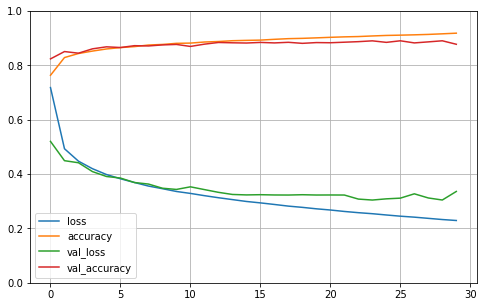

In [35]:
import pandas as pd
import matplotlib.pyplot as plt
pd.DataFrame(history.history).plot(figsize=(8,5))
plt.grid(True)
plt.gca().set_ylim(0, 1)
plt.show()

* **The training accuracy and the validation accuracy steadily increase during trianing, while the training loss and the validation loss decrease.**
* **The validation curves are close to the training curves, wnich means there is not too much overfitting.**
* **When ploting the training curve, it should be shiftedd by half an epoch to the left**
    * **The validation error is computed at the end of each epoch, while the training error is computed usimng a running mean during each epoch. So the training curve should be shifted by half and epoch to the left.**

**Once you are satisfied with your model's validation accuracy, you should evaluate it on the test set to estimate the generalization error before you deploy the model to production.**
**You can easily do this using the** evaluate() **method**

In [36]:
model.evaluate(X_test, y_test)

313/313 [==============================] - 0s 895us/step - loss: 0.3714 - accuracy: 0.8649


[0.3714033365249634, 0.8648999929428101]

### Using the model to make predictions
* **We can use the model's** predict() **method to make predicitons on new instacnes**

In [37]:
X_new = X_test[:3]

In [38]:
y_proba = model.predict(X_new)

* **For each insrance, predict estimates one probability per calkss, from class 0 to class 9.**

In [39]:
y_proba.round(2)

array([[0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.01, 0.  , 0.99],
       [0.  , 0.  , 1.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ],
       [0.  , 1.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ]],
      dtype=float32)

* **If you only care about the class with the highest estimated probability(even if that probability is quite low), then you can use the** np.argmax(model.predict(X_new), axis=-1) **method instead.**

In [43]:
y_pred = np.argmax(model.predict(X_new), axis=-1)

In [44]:
y_pred

array([9, 2, 1])

In [45]:
np.array(class_names)[y_pred]

array(['Ankle boot', 'Pullover', 'Trouser'], dtype='<U11')

In [46]:
y_new = y_test[:3]

In [47]:
y_new

array([9, 2, 1], dtype=uint8)

### Building a Regression MLP Using the Sequential API
***California Housing Problem***<br>
* **Load the data using sk-learn**

In [49]:
from sklearn.datasets import fetch_california_housing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [50]:
housing = fetch_california_housing()

X_train_full, X_test, y_train_full, y_test = train_test_split(
housing.data, housing.target)
X_train, X_valid, y_train, y_valid = train_test_split(
X_train_full, y_train_full)

scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_valid = scaler.transform(X_valid)
X_test = scaler.transform(X_test)

* **The ouutput layer has a single neuron(since we only want to predict a single value) and uses no activation, and the loss function is the mean squared error.**
* **Since the dataset is quite noisy, we just use a hidden layer with fewer neurons than before, to avoid overfitting.**

In [51]:
model = keras.models.Sequential([
    keras.layers.Dense(30, activation = "relu", input_shape=X_train.shape[1:]),
    keras.layers.Dense(1)
])

In [52]:
model.compile(loss="mean_squared_error", optimizer="sgd")

In [55]:
history = model.fit(X_train, y_train, epochs = 20,
                   validation_data=(X_valid, y_valid))

Epoch 1/20
363/363 [==============================] - 0s 1ms/step - loss: 0.9066 - val_loss: 0.6801
Epoch 2/20
363/363 [==============================] - 0s 773us/step - loss: 0.6542 - val_loss: 0.4872
Epoch 3/20
363/363 [==============================] - 0s 770us/step - loss: 0.4658 - val_loss: 0.4635
Epoch 4/20
363/363 [==============================] - 0s 723us/step - loss: 0.4466 - val_loss: 0.4582
Epoch 5/20
363/363 [==============================] - 0s 783us/step - loss: 0.4368 - val_loss: 0.4398
Epoch 6/20
363/363 [==============================] - 0s 788us/step - loss: 0.4293 - val_loss: 0.4297
Epoch 7/20
363/363 [==============================] - 0s 725us/step - loss: 0.4171 - val_loss: 0.4260
Epoch 8/20
363/363 [==============================] - 0s 716us/step - loss: 0.4137 - val_loss: 0.4163
Epoch 9/20
363/363 [==============================] - 0s 757us/step - loss: 0.4065 - val_loss: 0.4142
Epoch 10/20
363/363 [==============================] - 0s 766us/step - loss: 0.4032 

In [56]:
mse_test = model.evaluate(X_test, y_test)

162/162 [==============================] - 0s 567us/step - loss: 0.3521


In [57]:
X_new = X_test[:3]

In [58]:
y_pred = model.predict(X_new)

### Building Complex Models Using the Function API
* **It connects all or part of the inputs directly to the output layer.**
* **This architecture makes it possible for the neural network to learn both deep patterns(using the deep path) and simple rules(through the short path).**
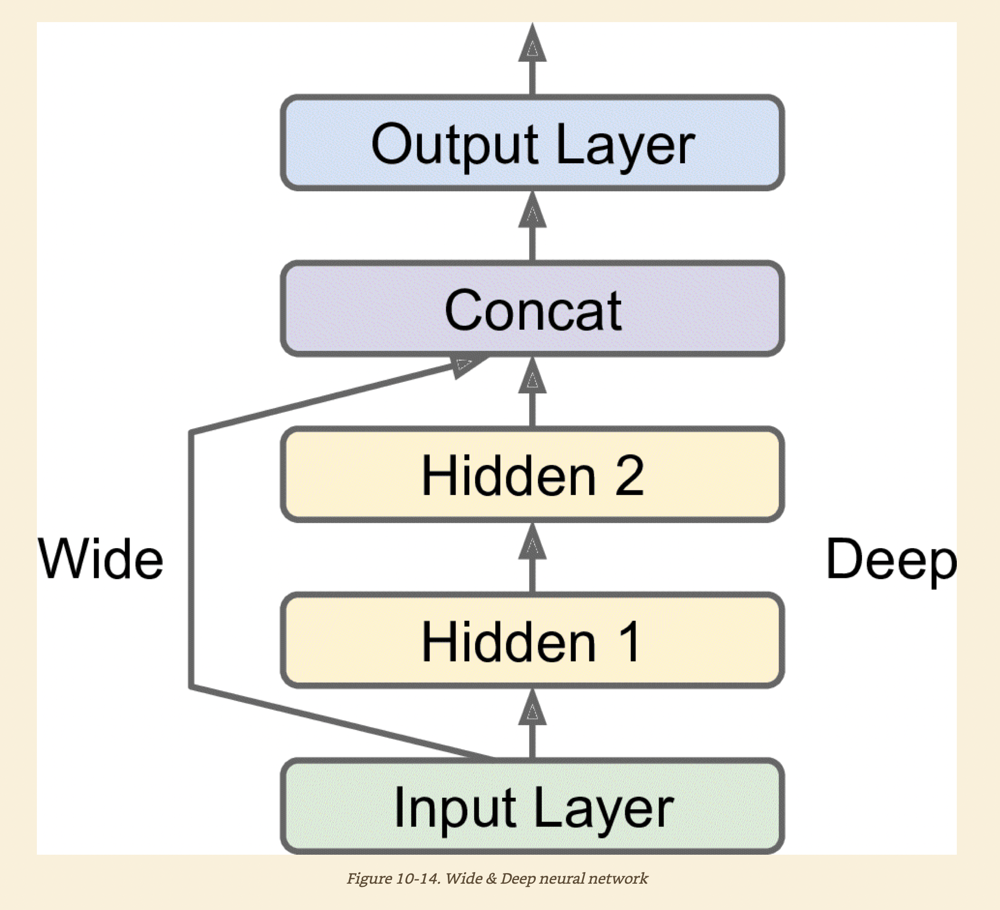

In [60]:
input_ = keras.layers.Input(shape=X_train.shape[1:])
hidden1 = keras.layers.Dense(30, activation="relu")(input_)
hidden2 = keras.layers.Dense(30, activation="relu")(hidden1)
concat = keras.layers.Concatenate()([input_, hidden2])
output = keras.layers.Dense(1)(concat)
model = keras.Model(inputs=[input_], outputs=[output])

* **First, we need to create an** Input **objet. This is a specification of the kind of input th model will get, including its** shape **and** dtype.
* **Create a Dense layer with 30 neurons. As soon as it is created, notice that we call it like a function, passing it the input. We are telling Keras how it should connect the layers together, no actual data is being processed yet.**
* **We then create a second hidden layer, and agian we use it like a function. Note that we pass it the output of the first hidden layer.**
* **Next, we create a** Concatenate **layer, and once again we immediately use it like a function, to concatenate the input and the output of the second hidden layer.**
* **Then we create the output layer, with a sinhle neuron and no activation function, and we call it like a function, passing it the result of the concatenation.**
* **Lastly, we create a Keras model, specifying which inputs and outputs to use.**

* **What if you want to send a subset of the features through the wide path and a different subset(possibly overlapping) through the deep path?**
    * **In this case, one solution is to use multiple inputs.**

**Sending five features tgrough the wide path(features 0 to 4), and six features through the deep path(features 2 to 7)**
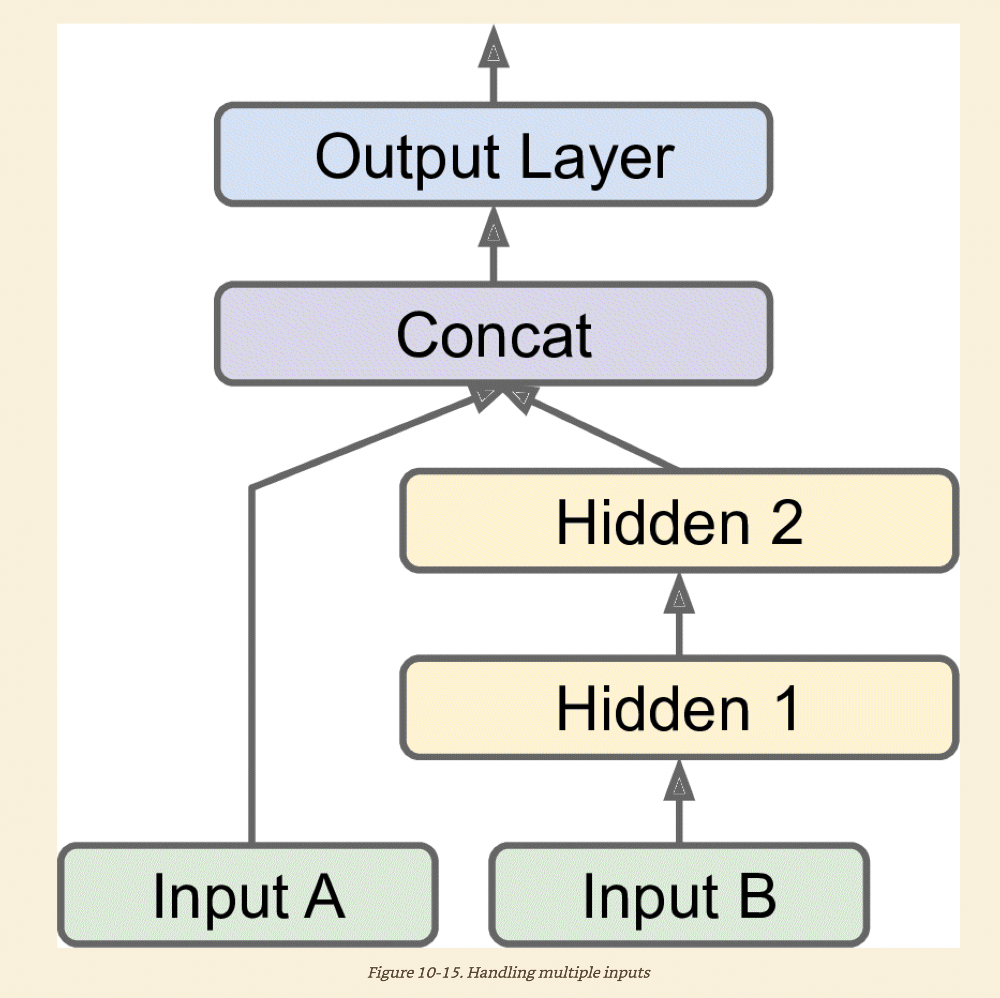

In [61]:
input_A = keras.layers.Input(shape=[5], name="wide_input")
input_B = keras.layers.Input(shape=[6], name="deep_input")
hidden1 = keras.layers.Dense(30, activation="relu")(input_B)
hidden2 = keras.layers.Dense(30, activation="relu")(hidden1)
concat = keras.layers.concatenate([input_A, hidden2])
output = keras.layers.Dense(1, name="output")(concat)
model = keras.Model(inputs=[input_A, input_B], outputs=[output])

* **When calling the fit( ) method, instead of passing a single input matrix X\_train, we must pass a pair of matrices (X\_train\_A, X\_train\_B): one per inpit.**
* **The same is true for X\_valid, and also for X\_test and X\_new when you call the evaluate( ) or predict( )**

In [62]:
model.compile(loss="mse", optimizer=keras.optimizers.SGD(lr=1e-3))

X_train_A, X_train_B = X_train[:, :5], X_train[:, 2:]
X_valid_A, X_valid_B = X_valid[:, :5], X_valid[:, 2:]
X_test_A, X_test_B = X_test[:, :5], X_test[:, 2:]
X_new_A, X_new_B = X_test_A[:3], X_test_B[:3]

history = model.fit((X_train_A, X_train_B), y_train, epochs=20,
                   validation_data=((X_valid_A, X_valid_B), y_valid))


Epoch 1/20
363/363 [==============================] - 0s 949us/step - loss: 1.9004 - val_loss: 0.9200
Epoch 2/20
363/363 [==============================] - 0s 641us/step - loss: 0.8399 - val_loss: 0.7712
Epoch 3/20
363/363 [==============================] - 0s 720us/step - loss: 0.7343 - val_loss: 0.7083
Epoch 4/20
363/363 [==============================] - 0s 800us/step - loss: 0.6893 - val_loss: 0.6753
Epoch 5/20
363/363 [==============================] - 0s 801us/step - loss: 0.6603 - val_loss: 0.6518
Epoch 6/20
363/363 [==============================] - 0s 798us/step - loss: 0.6384 - val_loss: 0.6338
Epoch 7/20
363/363 [==============================] - 0s 777us/step - loss: 0.6207 - val_loss: 0.6213
Epoch 8/20
363/363 [==============================] - 0s 839us/step - loss: 0.6055 - val_loss: 0.6089
Epoch 9/20
363/363 [==============================] - 0s 724us/step - loss: 0.5912 - val_loss: 0.5964
Epoch 10/20
363/363 [==============================] - 0s 621us/step - loss: 0.577

In [63]:
mse_test = model.evaluate((X_test_A, X_test_B), y_test)

162/162 [==============================] - 0s 471us/step - loss: 0.4763


In [65]:
y_pred = model.predict((X_new_A, X_new_B))
y_pred

array([[1.6646569],
       [2.2001734],
       [2.7036479]], dtype=float32)

#### There are many use cases in which you may want to have multiple outputs
* **The task may demand it. For instance, you may want to locate and classify the main object in a pircture. THis is both a regression task and a classification task.**
* **Similarly, you may have multiple independent tasks based on the same data. In many cases you will get better results on all tassks by training a single neural network with one output per task. This is because the neural network can learn features in the data that are usful across tasks.**
* **Another use case is as a regularization technique(i.e., a trianing constraint whose objective is to reduce overfitting adn thus improve the model's ability to generalize).**
    * **For example, you may want to add some auxiliary outputs in a neural network architecture to ensure that the underlying part of the network learns something useful on its own, without relying on the rest of the network.**
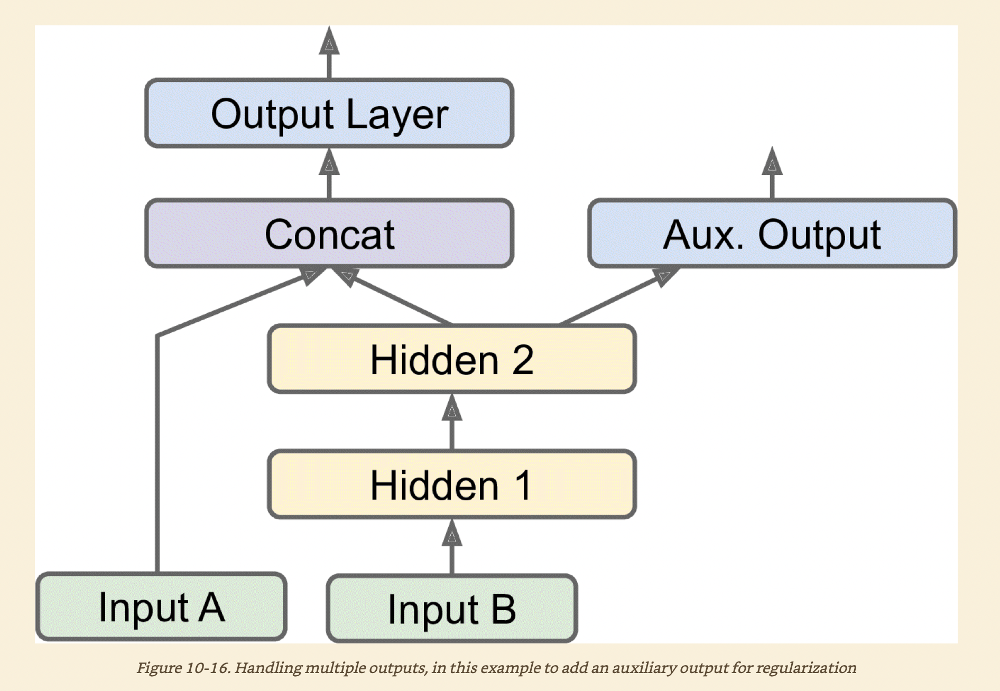

**Adding extra outputs is quite easy: just connect them to the appropriate layes and add them to you model's list of outputs**

In [67]:
input_A = keras.layers.Input(shape=[5], name="wide_input")
input_B = keras.layers.Input(shape=[6], name="deep_input")
hidden1 = keras.layers.Dense(30, activation="relu")(input_B)
hidden2 = keras.layers.Dense(30, activation="relu")(hidden1)
concat = keras.layers.concatenate([input_A, hidden2])

In [69]:
output = keras.layers.Dense(1, name="main_output")(concat)
aux_output = keras.layers.Dense(1, name="aux_output")(hidden2)
model = keras.Model(inputs=[input_A, input_B], outputs=[output, aux_output])

* **Each output will need its own loss function. Therefore, when we compile the model, we should pass a list of losses(if we pass a single loss, Keras will assume that the same loss must be used for all outputs)**
* **By default, Keras will compute all these losses and simply add them up to get the final loss used for training**
    * **We care much more about the main output than about the auxiliary outout(as it is just used for regulization), so we want to give the main output's loss a much greater weight.**

In [70]:
model.compile(loss=["mse", "mse"], loss_weights=[0.9, 0.1], optimizer="sgd")

* **Now we need to train the model, we need to provide labels for each output.**
    * **In this example, the main output and the auxiliary output should try to predict the same thing, so they should use the same labels.**
    * **Instead of passing y\_train, we need to pass (y\_train, y\_train) (and the same goes for y\_valid and y\_test)**

In [71]:
history = model.fit(
[X_train_A, X_train_B], [y_train, y_train], epochs=20,
validation_data=([X_valid_A, X_valid_B], [y_valid, y_valid]))

Epoch 1/20
363/363 [==============================] - 1s 1ms/step - loss: 1.0142 - main_output_loss: 0.9250 - aux_output_loss: 1.8172 - val_loss: 0.8297 - val_main_output_loss: 0.7878 - val_aux_output_loss: 1.2073
Epoch 2/20
363/363 [==============================] - 0s 890us/step - loss: 0.7549 - main_output_loss: 0.7142 - aux_output_loss: 1.1213 - val_loss: 0.9665 - val_main_output_loss: 0.9386 - val_aux_output_loss: 1.2179
Epoch 3/20
363/363 [==============================] - 0s 851us/step - loss: 1.0581 - main_output_loss: 1.0008 - aux_output_loss: 1.5733 - val_loss: 0.6484 - val_main_output_loss: 0.5700 - val_aux_output_loss: 1.3548
Epoch 4/20
363/363 [==============================] - 0s 866us/step - loss: 0.6070 - main_output_loss: 0.5550 - aux_output_loss: 1.0748 - val_loss: 0.5596 - val_main_output_loss: 0.5144 - val_aux_output_loss: 0.9665
Epoch 5/20
363/363 [==============================] - 0s 851us/step - loss: 0.5289 - main_output_loss: 0.4899 - aux_output_loss: 0.8801 - 

* **When we evaluate the model, Keras will return the total loss, as well as the individual losses**

In [72]:
total_loss, main_loss, aux_loss = model.evaluate(
[X_test_A, X_test_B], [y_test, y_test])

162/162 [==============================] - 0s 655us/step - loss: 0.3599 - main_output_loss: 0.3396 - aux_output_loss: 0.5427


* **The predict() method will return predictions for each output**

In [73]:
y_pred_main, y_pred_aux = model.predict([X_new_A, X_new_B])

### Using the Subclassing API to Build Dynamic Models
* **Both the Sequential API and the Functional API are declarative: you start by declaring which layers you want to use and how they should be connected, and only then can you start feeding the model some data for training and inference.**
    * **Advantages: Model can be easily saved, cloned, and shared; its structure can be displayed and analyzed; the framwork can infer shapes and check types, so errors can be caught early. It's also fairly easy to debug**
    * **Drawabacls: It's static. Some models involve loops, varying shapes, conditional branching, and other dynamic behaviours.**

#### Subclassing API
* **Create the layers you need in the constructor, and use them to perform the computations you want in the call( ) method.**

In [74]:
class WideAndDeepModel(keras.Model):
    def __init__(self, units=30, activation="relu", **kwargs):
        super().__init__(**kwargs) #handle the standard arguments(e.g., name)
        self.hidden1 = keras.layers.Dense(units, activation=activation)
        self.hidden2 = keras.layers.Dense(units, activation=activation)
        self.main_output = keras.layers.Dense(1)
        self.aux_output = keras.layers.Dense(1)
        
    def call(self, inputs):
        input_A, input_B = inputs
        hidden1 = self.hidden1(input_B)
        hidden2 = self.hidden2(hidden1)
        concat = keras.layers.concatenate([input_A, hidden2])
        main_output = self.main_output(concat)
        aux_output = self.aux_output(hidden2)
        return main_output, aux_output

In [75]:
model = WideAndDeepModel()

* **We do not need to create the inputs; we just use the** input **argument to the** call( ) **method, and we separate the creation of the layers in the constructor from their usage in the** call( ) **method.**
* **You can do pretty much anything you want in the** call( ) **method. This makes it a great API for researchers experimenting with new ideas**
* **The extra flexibility does come at a cost: your model's architecuture is hidden within the** call( ) **method, so keras cannot easily inspect it; it cannot save or clone it; and when you call the** summary **method, you only get a list of layers,without any information on how they are connected to each other. Moreover, Keras cannot check types and shapes ahead of time, and it is easier to make mistakes.**

### Saving and Restoring a Model
* **When using the Sequential API**

In [77]:
model = keras.models.Sequential([
    keras.layers.Dense(30, activation = "relu", input_shape=X_train.shape[1:]),
    keras.layers.Dense(1)
])

In [78]:
model.compile(loss="mean_squared_error", optimizer="sgd")

In [79]:
history = model.fit(X_train, y_train, epochs = 20,
                   validation_data=(X_valid, y_valid))

Epoch 1/20
363/363 [==============================] - 0s 886us/step - loss: 0.8714 - val_loss: 0.6442
Epoch 2/20
363/363 [==============================] - 0s 764us/step - loss: 0.9017 - val_loss: 0.6463
Epoch 3/20
363/363 [==============================] - 0s 677us/step - loss: 0.5798 - val_loss: 2.3688
Epoch 4/20
363/363 [==============================] - 0s 718us/step - loss: 5.0134 - val_loss: 0.6645
Epoch 5/20
363/363 [==============================] - 0s 757us/step - loss: 0.5823 - val_loss: 0.4317
Epoch 6/20
363/363 [==============================] - 0s 697us/step - loss: 0.4109 - val_loss: 0.4148
Epoch 7/20
363/363 [==============================] - 0s 927us/step - loss: 0.4019 - val_loss: 0.4086
Epoch 8/20
363/363 [==============================] - 0s 841us/step - loss: 0.3952 - val_loss: 0.4408
Epoch 9/20
363/363 [==============================] - 0s 929us/step - loss: 0.3928 - val_loss: 0.4026
Epoch 10/20
363/363 [==============================] - 0s 835us/step - loss: 0.387

In [80]:
model.save("my_keras_model.h5")

* **Keras will use the HDF5 format to save both the model's architecture(including every layer's hyperparameters) and the values of all the model parameters for every layer(e.g., connection weights and biases). It also saves the optimizer(including its hyperparameters and any state it may have).**

**Loading the model**

In [81]:
model = keras.models.load_model("my_keras_model.h5")

* **This will work when using the Sequential API or the Functional API, but unfortunately not when using modle subclassing. You can use** save_weights( ) **and** load_weights( ) **to at least save and restore the model parameters, but you will need to save and restore everything else yourself**

* **When training on large datasets, you should not only save ypur model at the end of training, but also save checkpoints at regular intervals during training, to avoid losing everything if your computer crashes.**
    * **Use callbacks to tell the** fit( ) **method to save the checkpoints**

### Using Callbacks
* **The** fit( ) **method acceepts a** callback **argument that lets you specify a list of objects that Keras will call at the start and end of training, at the start and end of each epoch, and even before and after processing ech each.**
    * **The** ModelCheckpoint **callback saves checkpoints of your model at regular intervals during training, by default at the end of each epoch:**

In [82]:
checkpoint_cb = keras.callbacks.ModelCheckpoint("my_keras_model.h5")

In [83]:
history = model.fit(X_train, y_train, epochs=10, callbacks=[checkpoint_cb])

Epoch 1/10
363/363 [==============================] - 0s 543us/step - loss: 0.3618
Epoch 2/10
363/363 [==============================] - 0s 536us/step - loss: 0.3628
Epoch 3/10
363/363 [==============================] - 0s 540us/step - loss: 0.3605
Epoch 4/10
363/363 [==============================] - 0s 550us/step - loss: 0.3581
Epoch 5/10
363/363 [==============================] - 0s 541us/step - loss: 0.3583
Epoch 6/10
363/363 [==============================] - 0s 528us/step - loss: 0.3551
Epoch 7/10
363/363 [==============================] - 0s 525us/step - loss: 0.3558
Epoch 8/10
363/363 [==============================] - 0s 551us/step - loss: 0.3521
Epoch 9/10
363/363 [==============================] - 0s 500us/step - loss: 0.3577
Epoch 10/10
363/363 [==============================] - 0s 524us/step - loss: 0.3496


* **If you use a validation set during training, you can set** save_best_only = True **when creating the** ModelCheckpoint. **In this case, it will only save your model when its performance on the validation set is the best so far.**

**Implementing early stopping**

In [84]:
checkpoint_cb = keras.callbacks.ModelCheckpoint("my_keras_model.h5",
                                               save_best_only=True)
history = model.fit(X_train, y_train, epochs=10,
                   validation_data=(X_valid, y_valid),
                   callbacks=[checkpoint_cb])

Epoch 1/10
363/363 [==============================] - 0s 937us/step - loss: 0.3484 - val_loss: 0.3845
Epoch 2/10
363/363 [==============================] - 0s 685us/step - loss: 0.3496 - val_loss: 0.5033
Epoch 3/10
363/363 [==============================] - 0s 784us/step - loss: 0.3473 - val_loss: 0.3678
Epoch 4/10
363/363 [==============================] - 0s 804us/step - loss: 0.3460 - val_loss: 0.3637
Epoch 5/10
363/363 [==============================] - 0s 702us/step - loss: 0.3437 - val_loss: 0.3597
Epoch 6/10
363/363 [==============================] - 0s 658us/step - loss: 0.3418 - val_loss: 0.3609
Epoch 7/10
363/363 [==============================] - 0s 765us/step - loss: 0.3406 - val_loss: 0.3542
Epoch 8/10
363/363 [==============================] - 0s 713us/step - loss: 0.3414 - val_loss: 0.3683
Epoch 9/10
363/363 [==============================] - 0s 725us/step - loss: 0.3388 - val_loss: 0.3565
Epoch 10/10
363/363 [==============================] - 0s 765us/step - loss: 0.337

In [85]:
model = keras.models.load_model("my_keras_model.h5")

* **Another way to implement early stopping is to simply use the** EarlyStopping **callback. It will interrupt training whe it measures no progress on the validation set for a number of epochs(defined by the** patience **argument), and it will optionally roll back to the best model.**
* **You can combine both callbacks to save checkpoints of your model(in case your computer crashes) and interrupt traininhg early when there is no more progress(to avoid wasting time and resources).**

In [87]:
early_stopping_cb = keras.callbacks.EarlyStopping(patience=10, 
                                                 restore_best_weights=True)
history = model.fit(X_train, y_train, epochs=10,
                   validation_data=(X_valid, y_valid),
                   callbacks=[checkpoint_cb, early_stopping_cb])

Epoch 1/10
363/363 [==============================] - 0s 872us/step - loss: 0.3168 - val_loss: 0.3361
Epoch 2/10
363/363 [==============================] - 0s 749us/step - loss: 0.3200 - val_loss: 0.3481
Epoch 3/10
363/363 [==============================] - 0s 742us/step - loss: 0.3158 - val_loss: 0.3341
Epoch 4/10
363/363 [==============================] - 0s 867us/step - loss: 0.3154 - val_loss: 0.3330
Epoch 5/10
363/363 [==============================] - 0s 782us/step - loss: 0.3141 - val_loss: 0.3307
Epoch 6/10
363/363 [==============================] - 0s 704us/step - loss: 0.3146 - val_loss: 0.3326
Epoch 7/10
363/363 [==============================] - 0s 698us/step - loss: 0.3141 - val_loss: 0.3422
Epoch 8/10
363/363 [==============================] - 0s 733us/step - loss: 0.3217 - val_loss: 0.3515
Epoch 9/10
363/363 [==============================] - 0s 695us/step - loss: 0.3179 - val_loss: 0.3374
Epoch 10/10
363/363 [==============================] - 0s 660us/step - loss: 0.314

* **If you need extra control, you can easily write your own custom callbacks. As an example of how to do that, the following custom callback will display the ratio between the validation loss and the training loss during training(e.g., to detect overfitting)**

In [88]:
class PrintValTrainRatioCallback(keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs):
        print("\nval/train: {:.2f}".format(logs["val_loss"] / logs["loss"]))

### Using TensorBoard for Visulization
* **To use it, you must modify your program so that it outputs the data you want to visulize to special binary log files called *event files.***
* **Each binary data record is a *summary*. The TensorBoard server will monitor the log directory, and it will automatically pick up the changes and update the visulization: this allows you to visulize live data(with a short dela**
* **In general, you want to point the TensoBoard server to a root log directory and configure your program so that it writes to a different subdirectory every time it runs.**
    * **This way, the same TensorBoard server instance will allow you to visulize and compare data from multiple runs of your program, without getting everything mixed up.**

* **Define the root log directory wi will use for the TensorBoard logs, plus a small function that will generate a subdirectory path based on the current data and time so that it's different every run.**

In [90]:
import os
root_logdir = os.path.join(os.curdir, "my_logs")

def get_run_logdir():
    import time
    run_id = time.strftime("run_%Y_%m_%d-%H_%M_%S")
    return os.path.join(root_logdir, run_id)
    
run_logdir = get_run_logdir()

In [91]:
run_logdir

'./my_logs/run_2020_12_31-08_16_01'

**Keras provide a TensorBoard callback**

In [93]:
tensorboard_cb = keras.callbacks.TensorBoard(run_logdir)
history = model.fit(X_train, y_train, epochs=30,
                   validation_data=(X_valid, y_valid),
                   callbacks=[tensorboard_cb])

Epoch 1/30
  1/363 [..............................] - ETA: 0s - loss: 0.3638WARNING:tensorflow:From /Users/linghao/opt/anaconda3/lib/python3.8/site-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
363/363 [==============================] - 0s 952us/step - loss: 0.3161 - val_loss: 0.3991
Epoch 2/30
363/363 [==============================] - 0s 719us/step - loss: 0.3181 - val_loss: 0.3284
Epoch 3/30
363/363 [==============================] - 0s 724us/step - loss: 0.3137 - val_loss: 0.3404
Epoch 4/30
363/363 [==============================] - 0s 768us/step - loss: 0.3142 - val_loss: 0.3290
Epoch 5/30
363/363 [==============================] - 0s 929us/step - loss: 0.3141 - val_loss: 0.3301
Epoch 6/30
363/363 [==============================] - 0s 730us/step - loss: 0.3121 - val_loss: 0.3389
Epoch 7/30
363/363 [=======

* **By running this code, the** TensorBoard( ) **callback will take care of creating the log directory for you(along with its parent directories if needed), and during training it will create event files and write summaries to them**
* **There's one directory per run, each containing one subdirectory for training logs and one for validation lgs. Both contain event files, but the training logs also include profiling rraces: this allows TensorBoard to show you exactly how much time the model spent on each part of your model.**

**Starting the TensorBoard server. One way to do this is by running a command in a terminal.**

In [ ]:
$ tensorboard --logdir=./my_logs --port=6006

**Running tensorboard in Jupyter**
* **First line loads the TensorBoard extension, the second line starts a TensorBoard server on port 6006**

In [95]:
%load_ext tensorboard
%tensorboard --logdir=./my_logs --port=6006

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


* **Additionally, TensorFlow offers a lower-level API in the** tf.summary **package.**

### Fine-Tuning Neural Network Hyperparameters
**How do you know what combination of hyperparameters is the best for your task**<br>
* **One option is to simply try many combinations of hyperparameters and see which one works best on the validation set(or use K-fold cross-validation)**

**Use** GridSearchCV **or** RandomizedSearchCV **to explore the hyperparameter sapce.**
* **We need to wrap Keras models in objects that mimic greular Scikit-Learn regressors**

**Create a function that will build and compile a Keras model.**
* **Creates a simple** Sequential **model for univariate regression(only one output per neuron), with the given input shape and the given number of hidden layers and neurons, and it compiles it using an** SGD **optimizer configured with the specified learning rate.**

In [96]:
def build_model(n_hidden=1, n_neurons=30, learning_rate=3e-3, input_shape=[8]):
    model = keras.models.Sequential()
    model.add(keras.layers.InputLayer(input_shape=input_shape))
    for layer in range(n_hidden):
        model.add(keras.layers.Dense(n_neurons, activation="relu"))
    model.add(keras.layers.Dense(1))
    optimizer = keras.optimizers.SGD(lr=learning_rate)
    model.compile(loss="mse", optimizer=optimizer)
    return model

**Create a** KerasRegressor **based on this** build_model( ) **function**<br>
* **The** KerasRegressor **object is a thin wrapper around the keras model built using** built_model.
* **We can use this object like a regular Scikit-Learn regressor: we can train it using its** fit( ) **method, then evaluate it using its** score( ) **method, and use it to make predictions using its** predict( ) **method.**

In [97]:
keras_reg = keras.wrappers.scikit_learn.KerasRegressor(build_model)

In [100]:
keras_reg.fit(X_train,y_train, epochs=10,
             validation_data=(X_valid, y_valid),
             callbacks=[keras.callbacks.EarlyStopping(patience=10)])
mse_test = keras_reg.score(X_test, y_test)
y_pred = keras_reg.predict(X_new)

Epoch 1/10
363/363 [==============================] - 0s 884us/step - loss: 1.4719 - val_loss: 0.8829
Epoch 2/10
363/363 [==============================] - 0s 741us/step - loss: 0.9858 - val_loss: 0.6529
Epoch 3/10
363/363 [==============================] - 0s 670us/step - loss: 0.6185 - val_loss: 0.5950
Epoch 4/10
363/363 [==============================] - 0s 704us/step - loss: 0.5679 - val_loss: 0.5540
Epoch 5/10
363/363 [==============================] - 0s 749us/step - loss: 0.5343 - val_loss: 0.5242
Epoch 6/10
363/363 [==============================] - 0s 732us/step - loss: 0.5146 - val_loss: 0.5061
Epoch 7/10
363/363 [==============================] - 0s 694us/step - loss: 0.4986 - val_loss: 0.4987
Epoch 8/10
363/363 [==============================] - 0s 726us/step - loss: 0.4873 - val_loss: 0.4844
Epoch 9/10
363/363 [==============================] - 0s 680us/step - loss: 0.4798 - val_loss: 0.4774
Epoch 10/10
162/162 [==============================] - 0s 465us/step - loss: 0.439

* **Although we want to train hundreds of variants and see which one performs bets on the validation set. Since there are many hyperparameters, it is preferable to use a randomized search rather than a grid search**

In [101]:
from scipy.stats import reciprocal 
from sklearn.model_selection import RandomizedSearchCV

In [104]:
param_distribs = {
    "n_hidden": [0, 1, 2, 3],
    "n_neurons": np.arange(1, 100),
    "learning_rate": reciprocal(3e-4, 3e-2),
}

In [ ]:
rnd_search_cv = RandomizedSearchCV(keras_reg, param_distribs, n_iter=10, cv=3)

In [ ]:
rnd_search_cv.fit(X_train, y_train, epochs=100,
                 validation_data=(X_valid, y_valid),
                 callbacks=[keras.callbacks.EarlyStopping(patience=10)])

**When it's over, you can access the best parameters found, the best score, and the trained keras model like this.**

In [ ]:
rnd_search_cv.best_params_

In [ ]:
rnd_search_cv.best_score_

In [ ]:
model = rnd_search_cv.best_estimator_.model

**Zooming**<br>
**When a region of the space turns out to be good, it should be explored more.**
1. Hyperpot
1. Hyperras, kopt, Talos
1. Keras Tuner
1. Scikit-Optimize(skopt)
1. Spearmint
1. Hyperband
1. Sklearn-Deap

### Number of HIdden Layers
* **Real-world data is often structured in such a hiearhchical way, and deep neural netoworks automatically take advantage of this fact: lower hidden layers model low-level structures, intermediate hidden layers combine these low-level structures to model intermediate-level strctures, and the highest hidden layers and the output layer combine these intermediate structures to model high-level structures.**
* **Not only does this hiearhichal architecture help DNNs converge faster to a good solution, but it also improves their ability to generalize to new datasets.**
* **For many problems you can start with just one or two hidden layers and then neural network will work just fine.**
* **For complex problems, you can ramp up the number of hidden layers until you start overfitting the training set.**

### Number of Neurons per Hidden Layer
* **The number of neurons in the input and output layers is determined by the type of input and output your task requires.**
* **As for the hidden layers, it used to be common to size them to form a pyramid, with fewer and fewer neurons at each layer -- the rationale being that many low-level features can coalesce into dar fewer high-level features.**
* **Just like the number of layers, you can try increasing the number of neurons gradually until the network starts overfitting. But in practice, it's ofen simpler and more efficeint to pick a model with more layers and neurons than you actually need, then use early stopping and other regularization technqiues to prevent it from overfitting.**
* **In general, you will get more bang for you buck by increasing the number of layers instead of the number of neurons per layer.**

### Learning Rate, Batch Size, and Other Hyperparameters

#### Learning Rate
* **In general, the optimal learning rate is about half of the maximum learning rate(i.e., the learning rate above which the training algorithm diverges.**
* **One way to find a good learning rate is to train the model for a few hundred iterations, starting with very low learning rate and gradually increasing it up to a very large value.**
* **If you plot the loss as a function of the learning rate, you should see it dropping at first. But after a while, the learning rate will be too large, so the loss will shoot back up.**

#### Optimizer
* **Choosing a better optimizer than plain old Mini-batch Gradient Descent is also quite important.**

#### Batch Size
* **The main benefit of using large batch sizes is that hardware accelerators like GPUs can process them efficiently, so the training algorithms will see more instances per second.**
    * **In practice, large batch sizes often lead to training instabilities, especially at the beginning of training, and the resulting model may not generalize as well as a model trained with a small batch size.**

#### Activation Function
* **In genral, the ReLU activation function will be a good default for all hidden layers. For the output layer, it really depends on your task.**

#### Number of Iterations
* **In most cases, the number of training iterations does not need to be tweaked, just use early stopping instead.**<br>

**The optimal learning rate depends on the other hyperparameters-especially the batch size-so if you modify any hyperparameter, make sure to update the learning rate as well.**<br>

**For detailed explnation on tuning,** [cick here!](https://arxiv.org/pdf/1803.09820.pdf)

In [105]:
%%bash
git status

On branch main
Your branch is up to date with 'origin/main'.

Untracked files:
  (use "git add <file>..." to include in what will be committed)
	.ipynb_checkpoints/
	introduction to neural_networks.ipynb
	my_keras_model.h5
	my_logs/

nothing added to commit but untracked files present (use "git add" to track)


In [ ]:
##